<table>
<tr>
<td width=15%><img src="logo-uga.png"></img></td>
<td><center><h1> Projet de visualisations de données <br> Accidentologie des cyclistes sur le territoire français</h1></center></td>
<td width=15%><a href="https://github/Yanismicha" style="font-size: 16px; font-weight: bold">Micha Yanis <br> Andrew Hardwick <br> Khadija Oualla </a><br></a> </td>
</tr>
</table>

### **Sujet** : 

Le projet examine la sécurité des cyclistes, avec un accent particulier sur le rôle des infrastructures cyclables. Il vise à comprendre comment ces structures influencent la fréquence et la gravité des accidents de vélo.

### **Problématiques** :

- Quel impact les infrastructures cyclables ont-elles sur la sécurité des cyclistes ?
- Comment l'état et le type de ces infrastructures affectent-ils la fréquence des accidents de vélo ?

In [1]:
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

## Importation de notre jeu de donnée

In [2]:
data = pd.read_csv("accidents-velos_clean.csv",low_memory=False)

In [3]:
data.head()

,Unnamed: 0.2,Unnamed: 0.1,Unnamed: 0,Num_Acc,date,an,mois,jour,hrmn,dep,...,typevehicules,manoeuvehicules,numVehicules,_infos_commune.code_epci,code_postal,nom_commune_postal,latitude,longitude,nom_commune,nom_commune_complet
0,0,0,0,200500000030,2005-01-13,2005,janvier,jeudi,19:45,62,...,18,17,1.0,200033579.0,NaN,NaN,NaN,NaN,non renseigné,NaN
1,1,1,1,200500000034,2005-01-19,2005,janvier,mercredi,10:45,62,...,10,15,1.0,200018083.0,NaN,NaN,NaN,NaN,non renseigné,NaN
2,2,2,2,200500000078,2005-01-26,2005,janvier,mercredi,13:15,02,...,7,15,1.0,200071785.0,NaN,NaN,NaN,NaN,non renseigné,NaN
3,3,3,3,200500000093,2005-01-03,2005,janvier,lundi,13:30,02,...,7,21,1.0,200071991.0,NaN,NaN,NaN,NaN,non renseigné,NaN
4,4,4,4,200500000170,2005-01-29,2005,janvier,samedi,18:30,76,...,10,2,1.0,200084952.0,NaN,NaN,NaN,NaN,non renseigné,NaN


### **Présentation de la Base de Données** 

Pour notre étude, nous avons utilisé des données issues de la base des accidents corporel, couvrant les années 2005 à 2021. 

Cette base regroupe les informations concernant les accidents qui se sont produits sur les routes, nous offrent une vue complète et précise sur les accidents, permettant ainsi une analyse approfondie des causes et des conséquences de ces incidents.


#### Description des Variables Clés de la Base de Données

Voici un aperçu des variables essentielles incluses dans notre base de données, chacune fournissant des informations détaillées sur les accidents de vélo :

- **Num_Acc**: Numéro d'identification unique de l'accident.
- **date**:  Date de l'accident.
- **an**: Année de l'accident.
- **mois**: Mois de l'accident.
- **jour**: Jour de la semaine de l'accident.
- **hrmn**: Heure et minute de l'accident.
- **dep**: Code du département où l'accident a eu lieu.
- **com**: Code INSEE de la commune où l'accident a eu lieu, composé du code du département suivi de trois chiffres.
- **lat, long**: Coordonnées géographiques de l'accident (latitude et longitude).
- **grav**: Gravité de l'accident, classant les victimes en différentes catégories (indemne, tué, blessé hospitalisé, blessé léger).
- **sexe**: Sexe de la personne impliquée (masculin, féminin).
- **trajet**: Motif du déplacement au moment de l'accident (domicile-travail, domicile-école, etc.).
- **secu**:  Indicateur de port de dispositifs de sécurité, renseignant la présence et l'utilisation d'équipements de sécurité (ceinture, casque, dispositif pour enfants, etc.).
- **locp**: Localisation de la personne au moment de l'accident (sur chaussée, sur trottoir, sur accotement, etc.).
- **actp**: Activité de la personne au moment de l'accident (traversant, masqué, jouant, etc.).
- **etatp**: État de la personne après l'accident  (seul, accompagné, en groupe).
- **catr**: Catégorie de route où l'accident s'est produit (autoroute, route nationale, etc.).

- **circ**: Conditions de circulation (à sens unique, bidirectionnelle, à chaussées séparées, etc.).
- **nbv**: Nombre de voies de circulation sur la portion de route concernée.
- **vosp**: Présence d'une voie réservée aux piétons et cyclistes (piste cyclable, bande cyclable, voie réservée).
- **prof**: Profil de la route (plat, pente, sommet de côte, etc.)..
- **plan**: Tracé en plan de la route (rectiligne, en courbe, etc.).
- **lartpc, larrout**: Largeur de la chaussée ou du trottoir.
- **surf**: État de la surface de la route au moment de l'accident (normale, mouillée, enneigée, etc.).
- **infra**: Type d'infrastructure ou d'aménagement au lieu de l'accident (tunnel, pont, bretelle d'échangeur, etc.).
- **situ**: Situation de l'accident (sur chaussée, sur bande d'arrêt d'urgence, sur accotement, etc.).
- **env1**: Environnement immédiat de l'accident.
- **equipement**: Équipement du vélo ou de la personne impliquée, indiquant la présence et l'utilisation d'équipements de sécurité (casque, gants, airbag, etc.).
- **obs, obsm**: Obstacles fixes ou mobiles rencontrés lors de l'accident (véhicule en stationnement, arbre, piéton, véhicule, etc.).
- **choc**: Point de choc initial sur le véhicule.
- **manv**: Manœuvre principale avant l'accident.
- **vehiculeid**: Identifiant du véhicule impliqué.
- **typevehicules**: Type de véhicule impliqué.
- **manoeuvehicules**: Manœuvre du véhicule.
- **numVehicules**: Numéro du véhicule  impliqué dans l'accident.
- **infos_commune.code_epci**: Code EPCI de la commune où l'accident a eu lieu.

# Graphiques

Vous trouverez dans cette section une séléction de graphique que nous avons estimés les plus pertinents lors de l'analyse de notre jeu de données.  
En premier lieu, notre jeu de donnée contenant les accidents de vélo en france pour les années 2005 à 2021, nous avons choisis quelques graphiques sur l'évolution de ces accidents durant ces années en traitant notre jeu de donnée en tant que série temporelle.
Nous avons par la suite gardé quelques graphiques permettant principalement de répondre à une problématique:
- Quel sont les différents facteurs impliqués dans les accidents de cyclisme en France, ceux pouvant potentiellement être liés à une augmentation du nombre d'accidents et au contraire ceux pouvant être liés à une baisse de ces accidents?

## Evolution avec le temps

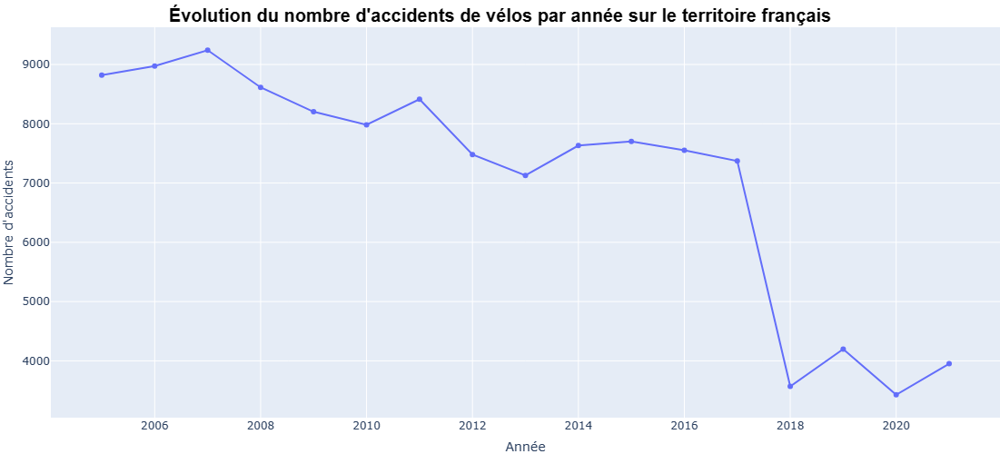

In [3]:
# on calcul les occurences des accidents par année
accidents_par_annee = data.groupby('an').size().reset_index(name='Nombre_d_accidents')
# Créer le lineplot pour la courbe évolutive
fig = px.line(accidents_par_annee, x="an", y="Nombre_d_accidents",
              markers=True,
             custom_data= ['an','Nombre_d_accidents'])
# taille de la figure (largeur, hauteur)
fig.update_layout(width=800, height=500)
#  ajout titre et axes
fig.update_layout(
                  xaxis_title="Année",
                  yaxis_title="Nombre d'accidents")
fig.update_layout(margin = {"r":0,"t":30,"l":0,"b":0},
                 title={
        'text': "<b>Évolution du nombre d\'accidents de vélos par année sur le territoire français</b>",
        'y': 0.98,
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top',
        'font': {'size': 20,'family': 'Arial, sans-serif', 'color': 'black'} 
    })

# Personnalisation du popup
fig.update_traces(hovertemplate="<br>".join(["Année : %{customdata[0]}",
                                             "Nombre d'accidents : %{customdata[1]}"
                                             ]),selector= 0)

# Afficher le graphique interactif
fig.show()

On peut observer une baisse moyenne du nombre d'accidents de vélo sur le territoire français entre 2005 et 2017 avec une chute drastique à partir de 2017. Il serait intéressant de se renseigner sur l'actualité cyliste de cette année afin d'en dégager des potentielles causes (loi adopté sur la sécurité routière, mise en place accru d'aménagements cyclables,ect.).  
Afin de bien rendre compte de nos valeurs et de visualiser une potentielle saisonnalité et tendance,on trace les accidents mois par mois:

C:\Users\Alex\AppData\Local\Temp\ipykernel_9568\3765656418.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  accidents_par_annee_mois= data.groupby(['an','mois']).size().reset_index(name='Nombre_d_accidents')


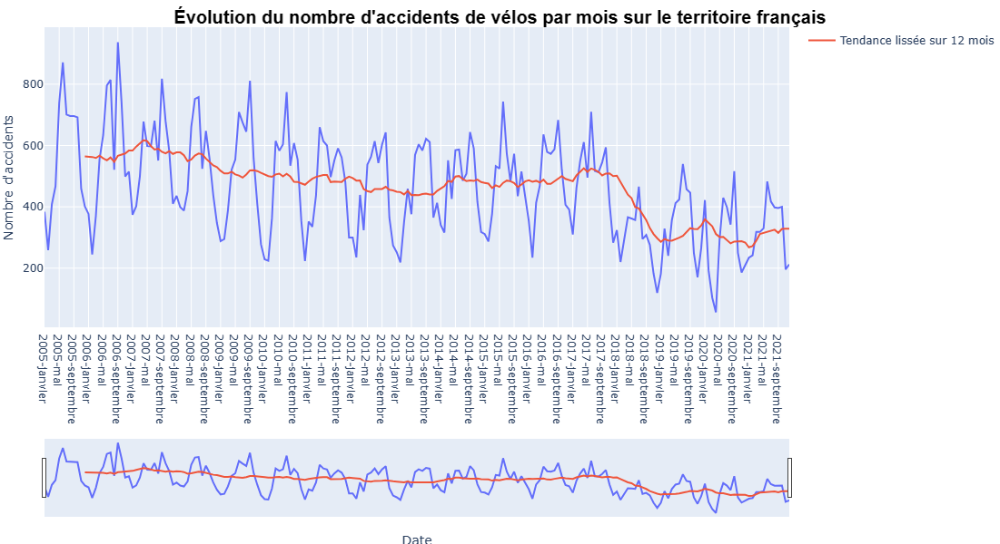

In [4]:
# on prdonne la variable mois pour avoir une année dans l'ordre
mois_ordre = ['janvier', 'février', 'mars', 'avril', 'mai', 'juin', 'juillet', 'août', 'septembre', 'octobre', 'novembre', 'décembre']
# Conversion de la variable 'mois' en facteur ordonnné
data['mois'] = pd.Categorical(data['mois'], categories=mois_ordre, ordered=True)

# on récupère les accidents par année et par mois
accidents_par_annee_mois= data.groupby(['an','mois']).size().reset_index(name='Nombre_d_accidents')
# Création d'une variable date en fusionnant les années et les mois
accidents_par_annee_mois['date'] = accidents_par_annee_mois['an'].astype(str) + '-' + accidents_par_annee_mois['mois'].astype(str)

# Création du graphique
fig = px.line(accidents_par_annee_mois, x='date', y='Nombre_d_accidents',
              labels={'date': 'Date', 'Nombre_d_accidents': 'Nombre d\'accidents'},
              height=600,
             custom_data = ['an','mois','Nombre_d_accidents'])

# Ajout de la courbe lissé pour observer une tendance
smoothed_data = accidents_par_annee_mois['Nombre_d_accidents'].rolling(window=12).mean() # 12 moyenne mobile pour enlever les saisonnalités annuelles
fig.add_trace(go.Scatter(x=accidents_par_annee_mois['date'], y=smoothed_data,
                         mode='lines', name='Tendance lissée sur 12 mois'))
# Titre
fig.update_layout(margin = {"r":0,"t":30,"l":0,"b":0},
                 title={
        'text': "<b>Évolution du nombre d\'accidents de vélos par mois sur le territoire français</b>",
        'y': 0.98,
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top',
        'font': {'size': 20,'family': 'Arial, sans-serif', 'color': 'black'} 
    })

#  slider pour zoomer sur une période donnée
fig.update_xaxes(rangeslider_visible=True)

# Personnalisation du popup
fig.update_traces(hovertemplate="<br>".join(["Année : %{customdata[0]}",
                                             "Mois : %{customdata[1]}",
                                             "Nombre d'accidents : %{customdata[2]}"
                                             ]),selector= 0)

# Afficher la figure
fig.show()

On observe une légère tendance du nombre d'accidents à diminuer avec le temps, avec encore une chute drastique en fin 2017 jusqu'en début 2019.  
Il serait intéressant également de retirer cette tendance afin de vérifier une potentielle saisonnalité (qui visuellement parait présente au premier abord).

**Bonus** : Visualisation des saisonnalités avec animation:

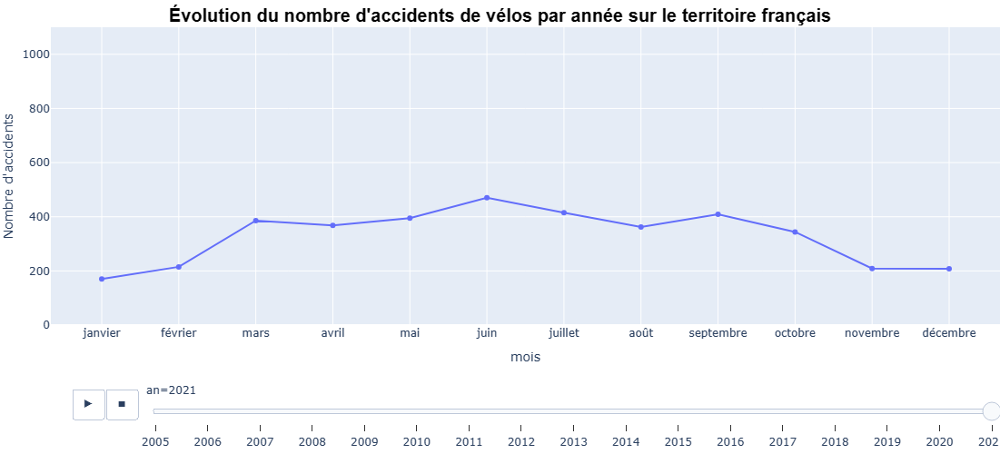

In [26]:
fig = px.line(accidents_par_annee_mois, x="mois", y="Nombre_d_accidents", 
              markers=True,animation_frame="an"
             ,custom_data=['an','mois','Nombre_d_accidents'])
# taille de la figure (largeur, hauteur)
fig.update_layout(width=800, height=500)
#  ajout titre et axes
fig.update_layout(title="Évolution du nombre d'accidents de vélos par année",
                  xaxis_title="mois",
                  yaxis_title="Nombre d'accidents"
                 )
# ralentir la vitese d'animation
fig.layout.updatemenus[0].buttons[0].args[1]["frame"]["duration"] = 1500

# changer l'echelle des ordonnées
fig.update_yaxes(range=[0, 1100])

# Titre
fig.update_layout(margin = {"r":0,"t":30,"l":0,"b":0},
                 title={
        'text': "<b>Évolution du nombre d\'accidents de vélos par année sur le territoire français</b>",
        'y': 0.98,
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top',
        'font': {'size': 20,'family': 'Arial, sans-serif', 'color': 'black'} 
    })

# Personnalisation du popup
fig.update_traces(hovertemplate="<br>".join(["Année : %{customdata[0]}",
                                             "Mois : %{customdata[1]}",
                                             "Nombre d'accidents : %{customdata[2]}"
                                             ]),selector= 0)

fig.show()

## Gravité des accidents

Nous aimerions savoir à quels endroits se passe les accidents en fonction de leur gravité afin d'avoir une première idée sur les lieux les plus sécuritaires et les plus dangereux pour les cyclistes.  
Pour cela nous avons fait le choix de réaliser un graphique composé d'un graphique en secteurs (*pie chart* en anglais) en fonction de la gravité (un par niveau de gravité de l'accident) constituant le nombre d'accidents par lieux:

In [23]:
# Regrouper des modalités sous la catégorie 'Autres'
data['situ'] = data['situ'].replace(['Non renseigné', 'Aucun','Autres','Sur autre voie spéciale'], 'Autres')

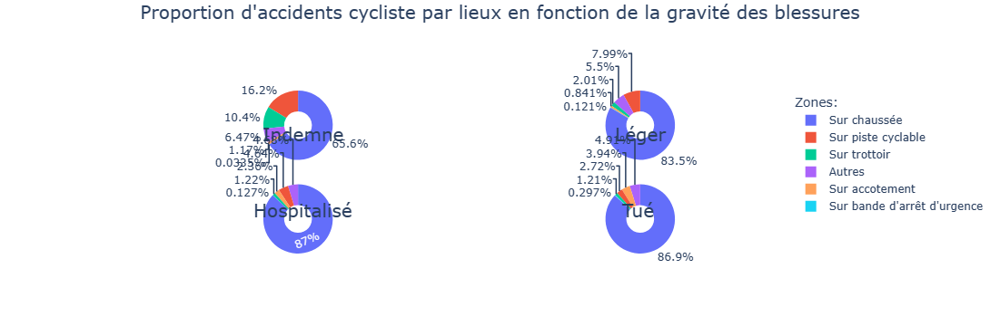

In [24]:
data_grav1 = data[data['grav'] == 'Indemne']
data_grav2 = data[data['grav'] == 'Blessé léger']
data_grav3 = data[data['grav'] == 'Blessé hospitalisé']
data_grav4 = data[data['grav'] == 'Tué']
loc1 = data_grav1.groupby('situ').size().reset_index(name="nombre_d'accidents")
values1 = loc1["nombre_d'accidents"].tolist()
loc2 = data_grav2.groupby('situ').size().reset_index(name="nombre_d'accidents")
values2 = loc2["nombre_d'accidents"].tolist()
loc3 = data_grav3.groupby('situ').size().reset_index(name="nombre_d'accidents")
values3 = loc3["nombre_d'accidents"].tolist()
loc4 = data_grav4.groupby('situ').size().reset_index(name="nombre_d'accidents")
values4 = loc4["nombre_d'accidents"].tolist()

# Correction de la spécification du subplot (specs)
fig = make_subplots(rows=2, cols=2, specs=[[{'type': 'domain'}, {'type': 'domain'}],
                                            [{'type': 'domain'}, {'type': 'domain'}]])

fig.add_trace(go.Pie(labels=loc1['situ'], values=values1, name="Indemne",
                     hovertemplate="Lieu: %{label}<br>Nombre d'accidents: %{value}<br>Pourcentage: %{percent}"),
              1, 1)
fig.add_trace(go.Pie(labels=loc2['situ'], values=values2, name="Léger",
                     hovertemplate="Lieu: %{label}<br>Nombre d'accidents: %{value}<br>Pourcentage: %{percent}"),
              1, 2)
fig.add_trace(go.Pie(labels=loc3['situ'], values=values3, name="Blessé hospitalisé",
                     hovertemplate="Lieu: %{label}<br>Nombre d'accidents: %{value}<br>Pourcentage: %{percent}"),
              2, 1)
fig.add_trace(go.Pie(labels=loc4['situ'], values=values4, name="Tué",
                     hovertemplate="Lieu: %{label}<br>Nombre d'accidents: %{value}<br>Pourcentage: %{percent}"),
              2, 2)


fig.update_traces(hole=0.4, hoverinfo="label+percent+name")
fig.update_layout(
    height = 800,title= "Proportion d'accidents cycliste par lieux en fonction de la gravité des blessures",
                  title_x=0.5,  # Centré horizontalement
                  title_y=0.98,  # Au-dessus du graphique
                  title_font=dict(size=20),
                 legend=dict(title="Zones:"),
    annotations=[dict(text='Indemne', x=0.165, y=0.81, font_size=20, showarrow=False),
                 dict(text='Léger', x=0.82, y=0.81, font_size=20, showarrow=False),
                 dict(text='Hospitalisé', x=0.15, y=0.19, font_size=20, showarrow=False),
                 dict(text='Tué', x=0.8, y=0.19, font_size=20, showarrow=False)]
    
)

fig.show()


On peut observer que la majorité des accidents se situe sur chaussé. De plus la proportion d'accidents sur chaussé augmente lorsque la gravité de l'accident augmente (tout comme les accidents sur accotement qui sont beaucoup plus important lorsque l'accident implique la mort de l'usager).  
C'est l'effet inverse qui se passe pour les accidents sur piste cyclable: la poportion de ces derniers diminue sensiblement lorsque la gravité de l'accident augmente passant de plus de 14% lorsque l'usager est indemne à moins de 4% lorsque l'usager à été tué lors de l'accident.  


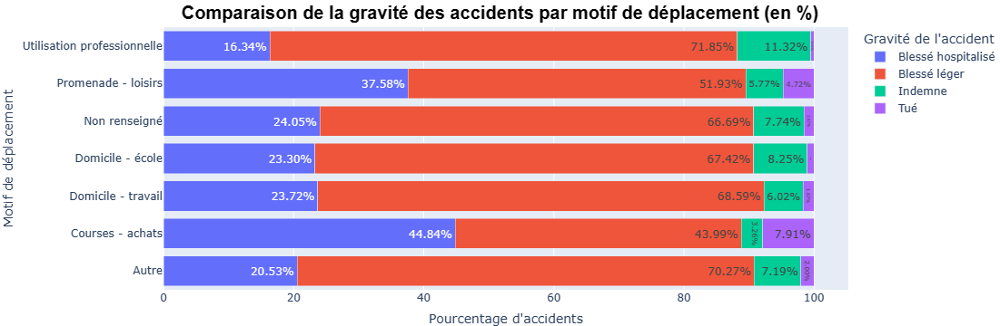

In [6]:
# On supprime les lignes où le trajet n'est pas indiqué
data_cleaned = data.drop(data[(data['trajet'].isna()) | (data['trajet'] == -1)].index)

# On calculer le nombre total d'accidents par motif de déplacement
total_accidents_by_trajet = data_cleaned.groupby('trajet').size().reset_index(name='Total_accidents')

# On calcule le nombre d'accidents en fonction du motif de déplacement et de la gravité de l'accident
trajet_grav = data_cleaned.groupby(['trajet', 'grav']).size().reset_index(name='Nombre_daccidents')

# On le fusionne avec le total pour calculer le pourcentage
trajet_grav = pd.merge(trajet_grav, total_accidents_by_trajet, on='trajet')
trajet_grav['Pourcentage'] = (trajet_grav['Nombre_daccidents'] / trajet_grav['Total_accidents']) * 100

# création du barplot groupé
fig = px.bar(trajet_grav,
             x='Pourcentage',
             y='trajet',
             color='grav',
             orientation='h',
             barmode='stack',
             labels={'Pourcentage': 'Pourcentage d\'accidents', 'grav': 'Gravité de l\'accident', 'trajet': 'Motif de déplacement'},
             custom_data=['grav', 'Nombre_daccidents', 'trajet'],
             )

# Personnalisation du popup
fig.update_traces(
    hovertemplate="<br>".join(["Gravité de l'accident : %{customdata[0]}",
                               "Nombre d'accidents : %{customdata[1]}",
                               "Motif de déplacement : %{customdata[2]}"
                              ]),
    # ajout du pourcentage dans les barres
    texttemplate='%{value:.2f}%', textposition='inside')

# Titre
fig.update_layout(margin = {"r":0, "t":30, "l":0, "b":0},
                  title={
    'text': "<b>Comparaison de la gravité des accidents par motif de déplacement (en %)</b>",
    'y': 0.98,
    'x': 0.5,
    'xanchor': 'center',
    'yanchor': 'top',
    'font': {'size': 20, 'family': 'Arial, sans-serif', 'color': 'black'} 
})

# Afficher le graphique
fig.show()


Lors des déplacements/ utilisations professionnelles  ou encore pour les déplacements Domicile -école, la proportion de blessure grave est assez modéré (environ un accident sur 5).  
 Mais quand il s'agit de déplacement pour le loisir ou pour des achats commerciales, la proportion d'accidents dont la gravité de  blessure est sérieuse est bien plus importante (jusqu'à un accident sur 2). 

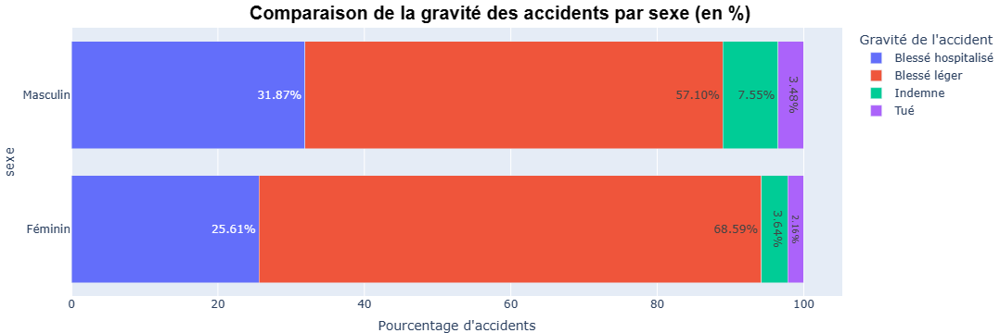

In [ ]:
# on supprime les lignes dont le sexe n'est pas indiqué
data = data.drop(data[data['sexe']=='-1'].index)

# Calcule le nombre total d'accidents par sexe
total_accidents_by_sex = data.groupby('sexe').size().reset_index(name='Total_accidents')

# Calculer le nombre d'accidents en fonction du sexe et de la gravité de la blessure
sex_grav = data.groupby(['sexe', 'grav']).size().reset_index(name='Nombre_daccidents')

# Fusionne avec le total pour calculer le pourcentage
sex_grav = pd.merge(sex_grav, total_accidents_by_sex, on='sexe')
sex_grav['Pourcentage'] = (sex_grav['Nombre_daccidents'] / sex_grav['Total_accidents']) * 100

# création du barplot groupé
fig = px.bar(sex_grav,
             x='Pourcentage',
             y='sexe',
             color='grav',
             orientation='h',
             barmode='stack',
             labels={'Pourcentage': 'Pourcentage d\'accidents', 'grav': 'Gravité de l\'accident'},
             custom_data=['grav','Nombre_daccidents','sexe'],
             )

# Personnalisation du popup
fig.update_traces(
   hovertemplate="<br>".join(["Gravité de l'accident : %{customdata[0]}",
                              "Nombre d'accidents : %{customdata[1]}",
                              "Sexe de l'usager : %{customdata[2]}"
                                             ]),
    # ajout du pourcentage dans les barres
texttemplate='%{value:.2f}%', textposition='inside')

# Titre
fig.update_layout(margin = {"r":0,"t":30,"l":0,"b":0},
                 title={
        'text': "<b>Comparaison de la gravité des accidents par sexe (en %)</b>",
        'y': 0.98,
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top',
        'font': {'size': 20,'family': 'Arial, sans-serif', 'color': 'black'} 
    })
# Afficher le graphique
fig.show()

Le graphique montre que les femmes sont proportionnellement plus susceptibles de subir des blessures légères à la suite d'un accident, tandis que les hommes présentent un taux plus élevé d'hospitalisation suite à leurs blessures.

Les incidents mortels sont légèrement moins fréquents chez les femmes que chez les hommes. En outre, les cas où les individus sortent indemnes d'un accident sont rares pour les deux sexes, avec un taudeux fois e plus bas chez les femme
De plus,le nombre d'accident total dont l'usager est une femme est 4 fois moins important que ceux dont l'usager est un homme, il serait intéressant de recouper cette information avec le porportion des deux sexes à utiliser fréquemment un vélos.

# Cartes interactives
Dans cette section, nous nous sommes efforcés de réaliser des cartes interactives permettant de mieux visualiser notre jeu de données et notamment de répondre à deux questions:  
- Quels sont les départements/régions les plus sécurisés pour les cyclistes durant la période de 2005 à 2021? (Autrement dit les lieux avec le moins d'accident).
- Dans quels endroits se situent les accidents de vélo en france entre 2005 et 2021 selon leur niveau de gravité?

    Pour ce qui est de la première question, nous avons décidé de créer deux cartes différentes.
La première est une carte de la france (avec les départements outre-mers) dans lequel nous retrouvons la quantité d'accidents par régions/départements avec la possibilité de changer la vue régions/départements à l'aide d'un boutton.  
La deuxième n'est constitué que d'une vue "département" mais avec cette fois un ratio  $\frac{\text{Nombre d'accidents}*1000}{\text{Population}}$  pour permettre de prendre en compte la densité de population dans chaque département. Les valeurs pour cette carte sont donc exprimés en nombre d'accidents pour 1000 habitants.

    Pour la deuxième question, une seule carte représentant le territoire français avec des points de différentes couleurs représentant l'ensemble des accidents de vélo entre 2005 et 2021 en fonction de la gravité de ces derniers.

Nous avons donc du récupérer les informations nécessaires dont ne dispose pas notre jeu de données: les noms et codes des régions ainsi que la quantité de population pour chaque département. 

## Chargement des jeu de données complémentaire

In [5]:
pop=pd.read_csv("pop_par_dep.csv",sep=";")
# jeu de donnée pour le code région
regions_code = pd.read_csv("communes-departement-region.csv")
# jeu de donnée pour le nom des régions
regions_name= pd.read_csv("departements-region.csv")
#mettre en forme le code departement
pop['Code Département']=pop['Code Département'].astype(str).str.zfill(2)

### Quels sont les départements/régions les plus sécurisés pour les cyclistes durant la période de 2005 à 2021?

**on fusionne les données pour récupérer les informations et on compte le nombre d'accidents par région**

In [6]:
#on récupère les noms des regions ainsi que les codes des régions
data_final = pd.merge(data, regions_name[['num_dep','region_name']], left_on='dep', right_on='num_dep',how='right')
# on compte le nombre d'accidents par région
accidents_par_reg= data_final.groupby('region_name').size().reset_index(name = "nombre d'accidents")
accidents_par_reg=pd.merge(accidents_par_reg, regions_code[['nom_region','code_region']], left_on='region_name', right_on='nom_region',how='right').drop_duplicates(subset='region_name', keep='first')

# on supprime les variables en double et remet les indices au propre
del accidents_par_reg['nom_region']
accidents_par_reg=accidents_par_reg.reset_index()
accidents_par_reg.drop(17,inplace=True)
accidents_par_reg=accidents_par_reg.reset_index()
del accidents_par_reg ['level_0']
del accidents_par_reg['index']
accidents_par_reg

,region_name,nombre d'accidents,code_region
0,Auvergne-Rhône-Alpes,9667.0,84.0
1,Hauts-de-France,6397.0,32.0
2,Provence-Alpes-Côte d'Azur,4667.0,93.0
3,Grand Est,8588.0,44.0
4,Occitanie,6629.0,76.0
5,Normandie,5533.0,28.0
6,Nouvelle-Aquitaine,9932.0,75.0
7,Centre-Val de Loire,3381.0,24.0
8,Bourgogne-Franche-Comté,4210.0,27.0
9,Bretagne,4557.0,53.0


On fait la même chose pour les départements, on récupère également la population.  
On créer également une variable ratio pour la deuxième carte:

In [7]:
accidents_par_dep = data.groupby('dep').size().reset_index(name = "nombre d'accidents")
# ajout des derniers départements outre mers
pop.loc[len(pop)] = ['978','Saint-Martin',72240,"",""]
pop.loc[len(pop)] = ['987','Polynésie française',306280,"",""]
pop.loc[len(pop)] = ['988','Nouvelle calédonie',210407,"",""]
# tri par département
pop = pop.sort_values('Code Département')
# fusion des deux datas
df=pd.merge(accidents_par_dep, pop[['Code Département','Population','Département']], left_on='dep', right_on='Code Département', how='right')
del df['Code Département']
# ajout de la variable ratio: nombre d'accidents pour 1000 habitants
df['ratio']=round(df["nombre d'accidents"]/df["Population"].astype('int64')*1000,2)

Création des cartes avec plotly:

### Première carte:

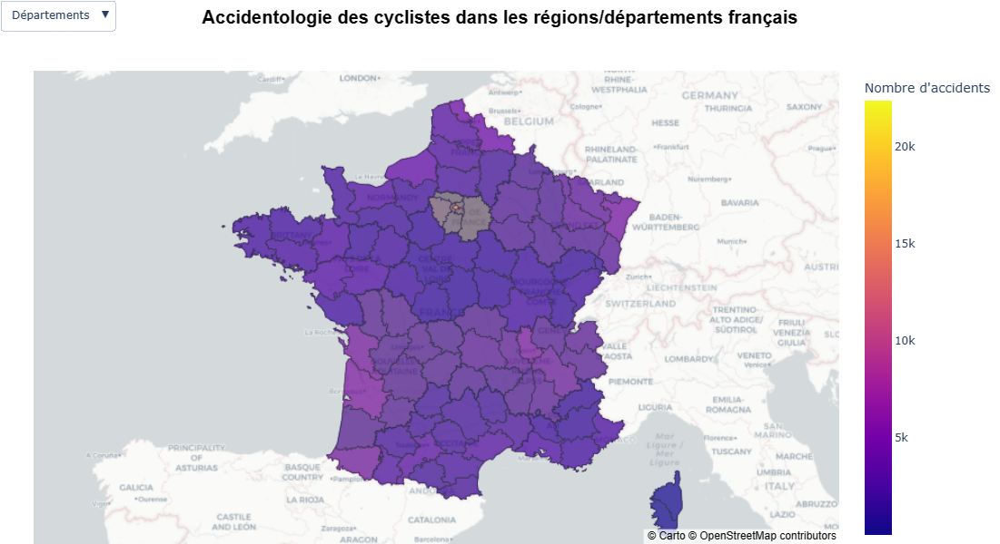

In [8]:

# Chargement des données
geojson_regions_url = 'https://raw.githubusercontent.com/gregoiredavid/france-geojson/master/regions.geojson'
geojson_departements_url = 'https://raw.githubusercontent.com/gregoiredavid/france-geojson/master/departements-avec-outre-mer.geojson'

# Création des cartes initiales
fig_regions = px.choropleth_mapbox(
    data_frame=accidents_par_reg,
    geojson=geojson_regions_url,
    locations='code_region',
    featureidkey='properties.code',
    color="nombre d'accidents",
    color_continuous_scale="thermal",
    mapbox_style="carto-positron",
    center={"lat": 46.7111, "lon": 1.7191},
    opacity=0.5,
    custom_data=["region_name","nombre d'accidents","code_region"],
)

fig_departements = px.choropleth_mapbox(
    data_frame=df,
    geojson=geojson_departements_url,
    locations='dep',
    featureidkey='properties.code',
    color="nombre d'accidents",
    color_continuous_scale="thermal",
    mapbox_style="carto-positron",
    # on centre sur la france
    center={"lat": 46.7111, "lon": 1.7191},
    opacity=0.5,
    custom_data=["dep","nombre d'accidents","Population","ratio"],
)



# Création de la figure avec des boutons pour basculer entre les cartes
updatemenus = [
    {
        'buttons': [
            
            {
                'args': [{'visible': [False, True]}],
                'label': 'Départements',
                'method': 'update'
            },
            {
                'args': [{'visible': [True, False]}],
                'label': 'Régions',
                'method': 'update'
            }
        ],
        'direction': 'down',
        'showactive': True,
        'x': 0.1,
        'xanchor': 'right',
        'y': 1.15,
        'yanchor': 'top'
    }
]

# Ajout des cartes invisibles
fig = go.Figure(data=[fig_regions.data[0], fig_departements.data[0]])
fig.update_layout(updatemenus=updatemenus, mapbox=dict(style="carto-positron", center={"lat": 46.7111, "lon": 1.7191}, zoom=4.6),height=600)
fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(coloraxis_colorbar_title='Nombre d\'accidents')
fig.update_layout(margin = {"r":0,"t":30,"l":0,"b":0},
                 title={
        'text': "<b>Accidentologie des cyclistes dans les régions/départements français</b>",
        'y': 0.98,
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top',
        'font': {'size': 20,'family': 'Arial, sans-serif', 'color': 'black'} 
    })

# fonction pour mettre à jour l'hover template
def update_hovertemplate(is_region_button):
    if is_region_button:
        return "<br>".join(["Région : %{customdata[0]}",
                            "Code :  %{customdata[2]}",
                            "Nombre d'accidents :  %{customdata[1]}"])
    else:
        return "<br>".join(["Département : %{customdata[0]}",
                            "Population : %{customdata[2]}",
                            "Nombre d'accidents :  %{customdata[1]}",
                            "Pour 1000 habitants : %{customdata[3]}"])


# Mettre à jour le hovertemplate pour les régions
fig.update_traces(hovertemplate=update_hovertemplate(True), selector=0)

# Mettre à jour le hovertemplate pour les départements
fig.update_traces(hovertemplate=update_hovertemplate(False), selector=1)

# Afficher la carte combinée
fig.show()

### Deuxième carte:

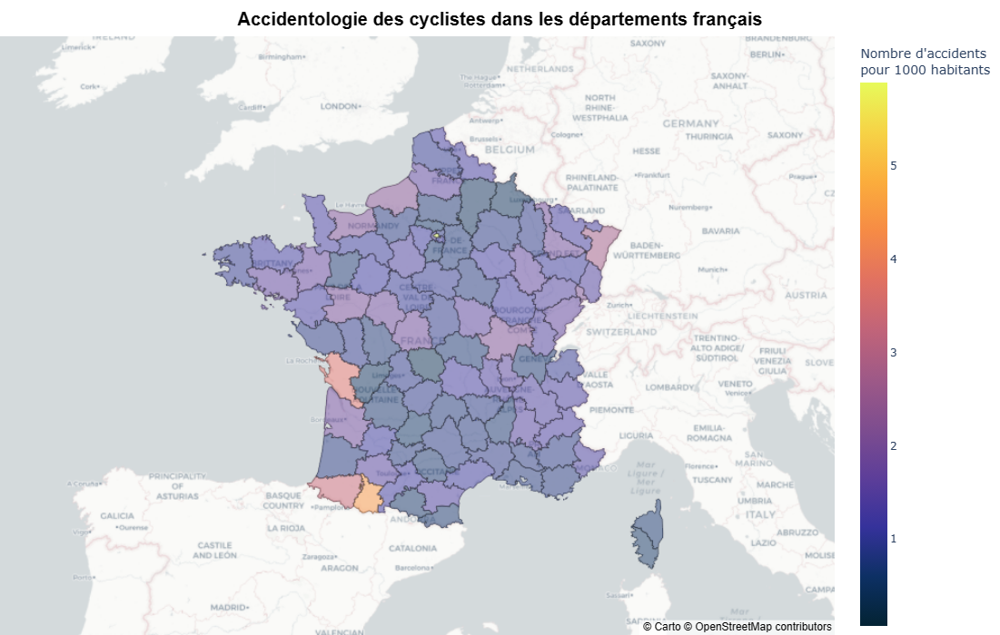

In [10]:
fig = px.choropleth_mapbox(
    df,
    geojson=geojson_departements_url,
    locations='dep',
    featureidkey='properties.code',
    color='ratio',
    color_continuous_scale="thermal", 
    mapbox_style="carto-positron",
    zoom=4.6,
    center={"lat": 46.7111, "lon": 1.7191},
    opacity=0.5,
    labels={'nombre_accidents': 'Nombre d\'accidents'},
    custom_data=["dep","Département","ratio"],
    height=700,
)
fig.update_layout(margin = {"r":0,"t":40,"l":0,"b":0},
                 coloraxis_colorbar_title='Nombre d\'accidents<br>pour 1000 habitants',
                 title={
        'text': "<b>Accidentologie des cyclistes dans les départements français</b>",
        'y': 0.98,
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top',
        'font': {'size': 20,'family': 'Arial, sans-serif', 'color': 'black'} 
    })
fig.update_traces(hovertemplate="<br>".join(["Département : %{customdata[1]}",
                                             "Numéro : %{customdata[0]}",
                                             "Nb d'accidents pour 1000 habitants : %{customdata[2]}"
                                             ]))

fig.show() 




### Quels sont les départements/régions les plus sécurisés pour les cyclistes durant la période de 2005 à 2021?

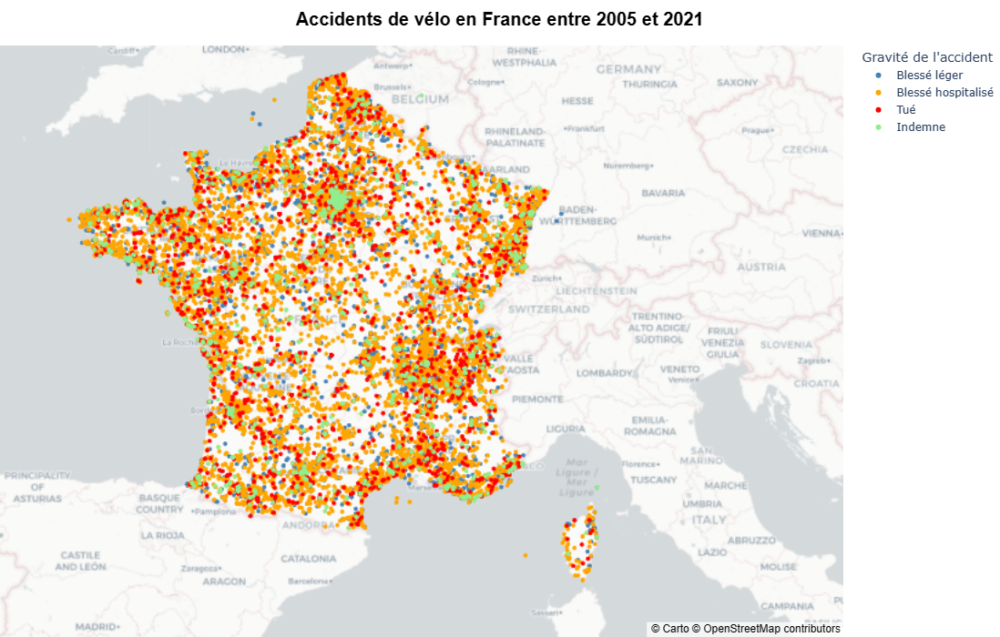

In [3]:
fig = px.scatter_mapbox(data, 
                        lat="lat", 
                        lon="long", 
                        mapbox_style="carto-positron", 
                        center={"lat":46.18, 'lon':4.7},
                        zoom=4.8,
                        custom_data=["date","hrmn","trajet", "int", "lum", 'dep','nom_commune'],
                        color='grav',
                        color_discrete_map = {'Blessé léger':'steelblue', 'Blessé hospitalisé':'orange', 'Tué':'red', 'Indemne':'lightgreen'},
                        height=700,
                        )


fig.update_traces(hovertemplate= "<br>".join([
                            "Date : %{customdata[0]}", 
                            "Heure : %{customdata[1]}", 
                            "Type de trajet : %{customdata[2]}", 
                            "Intersection: %{customdata[3]}", 
                            "Conditions d'éclairage: %{customdata[4]}",
                            "Département: %{customdata[5]}",
                            "Nom de la commune:  %{customdata[6]}"])
)

fig.update_layout(legend_title_text = "Gravité de l'accident",
                  margin={"r":0,"t":50,"l":0,"b":0},
                  title={
        'text': "<b> Accidents de vélo en France entre 2005 et 2021 </b>",
        'y': 0.98,
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top',
        'font': {'size': 20,'family': 'Arial, sans-serif', 'color': 'black'} 
    })